# Assignment 3: Path Tracer

In this assignment, you will implement a path tracer that can render scenes containing objects with different materials, as well as support a few different types of lights. By the end of the assignment your renderer will be able to create highly realistic images with global illumination.
The assignment consists of the following parts:

- Implementing light sources that cast shadows
- Implementing BRDFs
- Adding global illumination

## Interactive Renderer

We highly recommend using the interactive renderer to test your implementation in this assignment. The SlangPy library supports hot-reloading. This means that you can modify the shader code and see the changes immediately in the interactive renderer without restarting it. To use the interactive renderer, read the instructions in `docs/interactive-renderer.md` for basic usage. You can also refer to https://youtu.be/CZ-KqdD7frw for instructions on how to use the path tracer you implemented to render the scene in the interactive renderer.

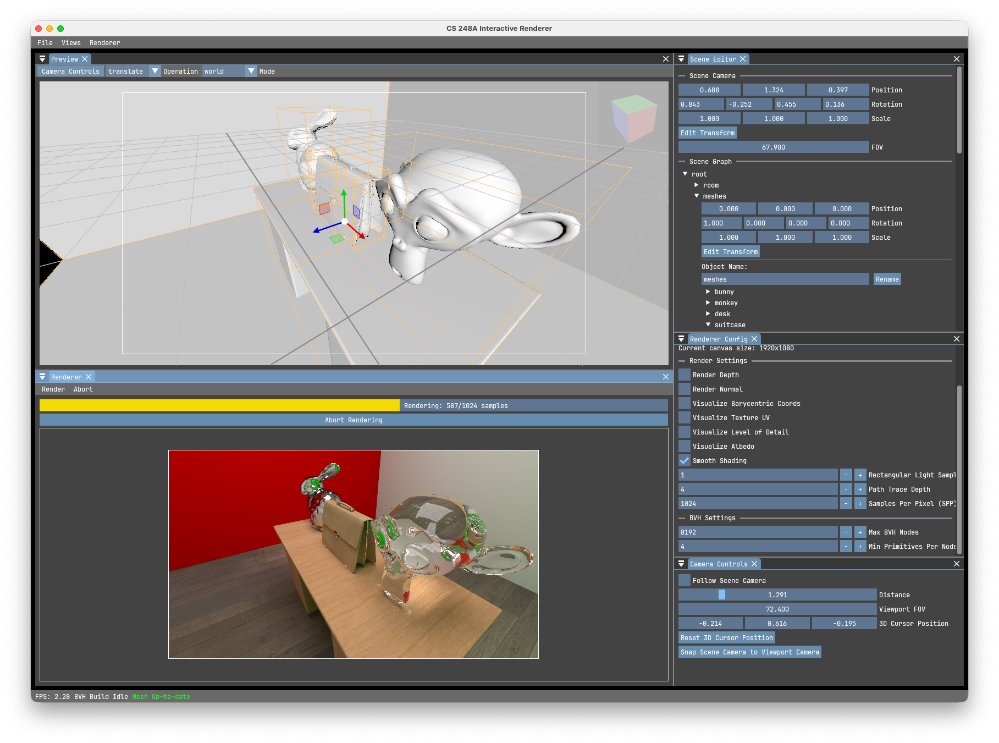

In [1]:
import open3d as o3d
from enum import Enum
from pyglm import glm
import numpy as np
from matplotlib import pyplot as plt
import slangpy as spy
from tqdm.notebook import tqdm
from time import time
import warnings
from PIL import Image


from cs248a_renderer import setup_device, RendererModules
from cs248a_renderer.model.bvh import BVH
from cs248a_renderer.model.transforms import Transform3D
from cs248a_renderer.model.material import PhysicsBasedMaterial, MaterialField, BRDFType
from cs248a_renderer.model.scene import Scene
from cs248a_renderer.model.mesh import Mesh
from cs248a_renderer.renderer.core_renderer import Renderer
from cs248a_renderer.model.lights import PointLight, DirectionalLight, RectangularLight
from cs248a_renderer.view_model.scene_manager import SceneManager

objc[24201]: Class GLFWHelper is implemented in both /Users/vishaljain/Downloads/Winter 2026/CS 248A/asst3/.venv/lib/python3.12/site-packages/open3d/cpu/pybind.cpython-312-darwin.so (0x12ef0fa28) and /Users/vishaljain/Downloads/Winter 2026/CS 248A/asst3/.venv/lib/python3.12/site-packages/slangpy/libsgl.dylib (0x14ebed248). This may cause spurious casting failures and mysterious crashes. One of the duplicates must be removed or renamed.
objc[24201]: Class GLFWApplicationDelegate is implemented in both /Users/vishaljain/Downloads/Winter 2026/CS 248A/asst3/.venv/lib/python3.12/site-packages/open3d/cpu/pybind.cpython-312-darwin.so (0x12ef0fa78) and /Users/vishaljain/Downloads/Winter 2026/CS 248A/asst3/.venv/lib/python3.12/site-packages/slangpy/libsgl.dylib (0x14ebed298). This may cause spurious casting failures and mysterious crashes. One of the duplicates must be removed or renamed.
objc[24201]: Class GLFWWindowDelegate is implemented in both /Users/vishaljain/Downloads/Winter 2026/CS 248

In [2]:
# Setup SlangPy device
device = setup_device([])

[INFO] (rhi) layer: CreateDevice: Debug layer is enabled.
[WARN] No supported shader model found, pretending to support sm_6_0.


In [3]:
renderer_modules = RendererModules(device)

[WARN] Slang compiler warnings:
/Users/vishaljain/Downloads/Winter 2026/CS 248A/asst3/src/cs248a_renderer/slang_shaders/./renderer/./mesh_renderer/mesh_material.slang(87): warning 41000: unreachable code detected
    return level;
    ^~~~~~



In [4]:
OUTPUT_IMG_SIZE = (512, 512)
output_image = device.create_texture(
    type=spy.TextureType.texture_2d,
    format=spy.Format.rgba32_float,
    usage=spy.TextureUsage.unordered_access,
    width=OUTPUT_IMG_SIZE[0],
    height=OUTPUT_IMG_SIZE[1],
)

In [5]:
renderer = Renderer(
    device=device,
    render_texture=output_image,
    render_modules=renderer_modules
)

In [6]:
def tone_mapping(image_np, gamma=2.2, exposure_time=1.0):
    gamma_corrected_image = np.power(image_np[:, :, :3] * exposure_time, 1.0 / gamma)
    return np.clip(gamma_corrected_image, 0.0, 1.0)


In [7]:
def build_bvh(scene):
    MAX_NODES = 8192
    triangles, materials = scene.extract_triangles_with_material()
    tqdm_bar = tqdm(total=MAX_NODES)
    def on_progress(current: int, total: int) -> None:
        tqdm_bar.n = current
        tqdm_bar.refresh()
    bvh = BVH(
        primitives=triangles,
        max_nodes=MAX_NODES,
        min_prim_per_node=4,
        on_progress=on_progress
    )

    return bvh, triangles, materials

#### Scene Definition
Download all the files from [https://drive.google.com/drive/folders/1kT2JPlwDfBr8oHNwdRPJnOsRY1iFvcUD?usp=drive_link](https://drive.google.com/drive/folders/1kT2JPlwDfBr8oHNwdRPJnOsRY1iFvcUD?usp=drive_link) and place in `./resources` directory.

In [8]:
class LightType(Enum):
    FLASH = "flash"
    POINT_LIGHT_AT_CAMERA = "point_at_camera"
    POINT_LIGHT_ON_THE_CEILING = "point_on_the_ceiling"
    DIRECTIONAL_LIGHT_INTO_THE_SCENE = "directional_into_the_scene"
    RECTANGULAR_LIGHT_ON_THE_CEILING = "rectangular_on_the_ceiling"
    RECTANGULAR_LIGHT_ON_THE_CEILING_DIMMER = "rectangular_on_the_ceiling_dimmer"

def getLight(light_type: LightType, light_transform: Transform3D, camera_position: glm.vec3):
    if light_type == LightType.FLASH:
        return None
    elif light_type == LightType.POINT_LIGHT_AT_CAMERA:
        return PointLight(position=camera_position, color=glm.vec3(1.0, 1.0, 1.0), intensity=1000.0)
    elif light_type == LightType.POINT_LIGHT_ON_THE_CEILING:
        return PointLight(transform=light_transform, position=glm.vec3(0.0), color=glm.vec3(1.0, 1.0, 1.0), intensity=500.0)
    elif light_type == LightType.DIRECTIONAL_LIGHT_INTO_THE_SCENE:
        return DirectionalLight(direction=glm.vec3(0.0, 0.0, -1.0), color=glm.vec3(1.0, 1.0, 1.0), intensity=5.0)
    elif light_type == LightType.RECTANGULAR_LIGHT_ON_THE_CEILING:
        return RectangularLight(
            transform=light_transform,
            vertices=[
                glm.vec3(-2.0, 0.0, -2.0),
                glm.vec3(2.0, 0.0, -2.0),
                glm.vec3(2.0, 0.0, 2.0),
                glm.vec3(-2.0, 0.0, 2.0)
            ],
            color=glm.vec3(1.0, 1.0, 1.0),
            intensity=10.0,
            doubleSided=False
        )
    elif light_type == LightType.RECTANGULAR_LIGHT_ON_THE_CEILING_DIMMER:
        return RectangularLight(
            transform=light_transform,
            vertices=[
                glm.vec3(-2.0, 0.0, -2.0),
                glm.vec3(2.0, 0.0, -2.0),
                glm.vec3(2.0, 0.0, 2.0),
                glm.vec3(-2.0, 0.0, 2.0)
            ],
            color=glm.vec3(1.0, 1.0, 1.0),
            intensity=5.0,
            doubleSided=False
        )

class CornellBoxMode(Enum):
    SIMPLE = "simple"
    SHADOW = "SHADOW"
    MIRROR_OBJECTS = "mirror_objects"
    DEFAULT_CORNELL_BOX = "default_cornell_box"
    GLASS_BALL = "glass_ball"

# We'll load the Stanford bunny model into our scene.
def get_cornell_box(mode: CornellBoxMode = CornellBoxMode.SIMPLE, light_type: LightType = LightType.FLASH, ior: float = 1.5):
    object_names = ['floor', 'left_wall', 'right_wall', 'back_wall', 'ceiling', 'bunny1', 'bunny2', 'ball1']
    object2brdf_mapping = {k: BRDFType.LAMBERTIAN for k in object_names}

    if mode == CornellBoxMode.SIMPLE:
        if light_type != LightType.FLASH:
            warnings.warn(f"Overriding light_type: {light_type} with {LightType.FLASH} in Cornell Box Mode: {mode}")
        light_type = LightType.FLASH
    elif mode == CornellBoxMode.MIRROR_OBJECTS:
        object2brdf_mapping['bunny2'] = BRDFType.MIRROR
    elif mode == CornellBoxMode.DEFAULT_CORNELL_BOX:
        light_type = LightType.RECTANGULAR_LIGHT_ON_THE_CEILING
        object2brdf_mapping['bunny2'] = BRDFType.MIRROR
    elif mode == CornellBoxMode.GLASS_BALL:
        object2brdf_mapping['ball1'] = BRDFType.GLASS


    ######## Create Cornell Box ########
    scene = Scene()
    # Set camera position and orientation
    cam = scene.camera
    eye = glm.vec3(0.0, 5.0, 20.0)
    cam.transform.position = eye
    # quat using lookat
    target = glm.vec3(0.0, 5.0, 0.0)
    cam.transform.rotation = glm.quatLookAt(glm.normalize(target - eye), glm.vec3(0.0, 1.0, 0.0))


    # A White colored Floor plane
    o3d_plane = o3d.io.read_triangle_mesh("../../resources/plane.obj")
    floor_plane = Mesh(o3d_plane)
    floor_plane.transform.scale = glm.vec3(5.0, 5.0, 5.0)
    floor_plane.material = PhysicsBasedMaterial(albedo=MaterialField(uniform_value=glm.vec3(1.0, 1.0, 1.0)), brdf_type=object2brdf_mapping['floor'])
    scene.add_object(floor_plane)

    # A Red coloredLeft Wall
    left_wall = Mesh(o3d_plane)
    left_wall.transform.position = glm.vec3(-5.0, 5.0, 0.0)
    left_wall.transform.rotation = glm.angleAxis(glm.radians(-90.0), glm.vec3(0.0, 0.0, 1.0))
    left_wall.transform.scale = glm.vec3(5.0, 5.0, 5.0)
    left_wall.material = PhysicsBasedMaterial(albedo=MaterialField(uniform_value=glm.vec3(1.0, 0.0, 0.0)), brdf_type=object2brdf_mapping['left_wall'])
    scene.add_object(left_wall)

    # A Green colored Right Wall
    right_wall = Mesh(o3d_plane)
    right_wall.transform.position = glm.vec3(5.0, 5.0, 0.0)
    right_wall.transform.rotation = glm.angleAxis(glm.radians(90.0), glm.vec3(0.0, 0.0, 1.0))
    right_wall.transform.scale = glm.vec3(5.0, 5.0, 5.0)
    right_wall.material = PhysicsBasedMaterial(albedo=MaterialField(uniform_value=glm.vec3(0.0, 1.0, 0.0)), brdf_type=object2brdf_mapping['right_wall'])
    scene.add_object(right_wall)

    # A White colored Back Wall
    back_wall = Mesh(o3d_plane)
    back_wall.transform.position = glm.vec3(0.0, 5.0, -5.0)
    back_wall.transform.rotation = glm.angleAxis(glm.radians(90.0), glm.vec3(1.0, 0.0, 0.0))
    back_wall.transform.scale = glm.vec3(5.0, 5.0, 5.0)
    back_wall.material = PhysicsBasedMaterial(albedo=MaterialField(uniform_value=glm.vec3(1.0, 1.0, 1.0)), brdf_type=object2brdf_mapping['back_wall'])
    if mode == CornellBoxMode.GLASS_BALL:
        back_wall.material = PhysicsBasedMaterial(
            albedo=MaterialField(
                uniform_value=glm.vec3(1.0, 1.0, 1.0),
                use_texture=True,
                texture_map_path="../../resources/uv_grid.png"
            ),
            brdf_type=object2brdf_mapping['back_wall']
        )
    scene.add_object(back_wall)

    # A White colored Ceiling
    ceiling = Mesh(o3d_plane)
    ceiling.transform.position = glm.vec3(0.0, 10.0, 0.0)
    ceiling.transform.rotation = glm.angleAxis(glm.radians(180.0), glm.vec3(1.0, 0.0, 0.0))
    ceiling.transform.scale = glm.vec3(5.0, 5.0, 5.0)
    ceiling.material = PhysicsBasedMaterial(albedo=MaterialField(uniform_value=glm.vec3(1.0, 1.0, 1.0)), brdf_type=object2brdf_mapping['ceiling'])
    scene.add_object(ceiling)

    # Add Lights to the scene
    light_transform = Transform3D(
        position=glm.vec3(0.0, 9.99, 0.0),
        rotation=glm.angleAxis(glm.radians(0.0), glm.vec3(1.0, 0.0, 0.0)),
        scale=glm.vec3(1.0, 1.0, 1.0)
    )

    # Place two bunnies in the scene: One with Lambertian BRDF and the other with Mirror BRDF
    if mode != CornellBoxMode.GLASS_BALL:
        o3d_mesh = o3d.io.read_triangle_mesh("../../resources/bunny.obj")
        bunny1 = Mesh(o3d_mesh)
        bunny1.transform.position = glm.vec3(-2.0, 1.0, -2.0)
        bunny1.material = PhysicsBasedMaterial(albedo=MaterialField(uniform_value=glm.vec3(1.0, 1.0, 1.0)), brdf_type=object2brdf_mapping['bunny1'])
        scene.add_object(bunny1)

        bunny2 = Mesh(o3d_mesh)
        bunny2.transform.position = glm.vec3(2.0, 1.0, 2.0)
        bunny2.material = PhysicsBasedMaterial(albedo=MaterialField(uniform_value=glm.vec3(1.0, 1.0, 1.0)), brdf_type=object2brdf_mapping['bunny2'])
        scene.add_object(bunny2)
    else:
        # Place two bunnies in the scene: One with Lambertian BRDF and the other with Mirror BRDF
        o3d_mesh = o3d.io.read_triangle_mesh("../../resources/uv_sphere_smooth.obj")
        ball1 = Mesh(o3d_mesh)
        ball1.transform.position = glm.vec3(0.0, 5.0, 0.0)
        ball1.transform.scale = glm.vec3(2.0, 2.0, 2.0)
        ball1.material = PhysicsBasedMaterial(albedo=MaterialField(uniform_value=glm.vec3(1.0, 1.0, 1.0)), brdf_type=object2brdf_mapping['ball1'])
        ball1.material.ior = ior
        scene.add_object(ball1)

    light = getLight(light_type, light_transform, eye)
    if light is not None:
        scene.add_object(light)

    return scene

## Part 1: Adding Light Sources that Cast Shadows

### A Simple Point Light
The easiest light source to think about is an isotropic point light source. This is a light source that emits radiance equally in all directions from a single point. In our code, a point light source is parameterized by three attributes:
- Position: the position of the point source in the world
- Color: the color of the light, which the relative intensity of its red, green, and blue components
- Intensity: the overall magnitude of the light

Check out `src/cs248a_renderer/slang_shaders/light/point_light.slang` for it's description.

Take a moment to take a look at the two major functions that make up the light interface: `sample()` and `getRadiance()`.  
The `sample()` generates a sample of the light source for Monte Carlo integration (and returns a `LightSample` struct representing the both the sample and the pdf associated with the sample).
The `getRadiance()` returns the radiance emitted by the light toward a surface point.

To use the point light in an illumination calculation, a Monte-Carlo estimator of the rendering equation is used. This estimator is located in `evaluatePointLightContribution` in `slang_shaders/renderer/mesh_renderer/mesh_illumination.slang`.

#### Reflection Equation

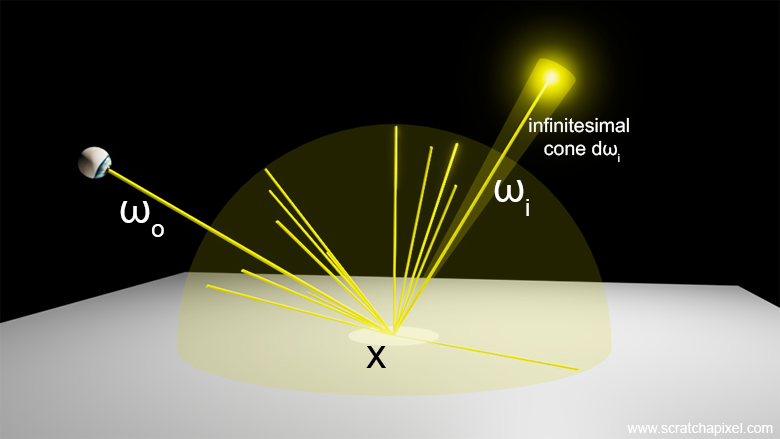

$$L_o(x, \omega_o) = \int_{\Omega} f_r(x, \omega_i, \omega_o) L_i(x, \omega_i) V(x, \omega_i) \cos\theta \, d\omega_i$$
Here is term by term breakdown of reflection equation. Refer to `evaluatePointLightContribution` and `getDirectIllumination` to follow along: 
1. x: It is a point on the surface at which incoming light ray bounces off. Referred to as `hitPoint` in our code.
2. $L_o(x, \omega_o)$ (Outgoing Radiance): It is the total amount of light leaving point $x$ in the specific direction $\omega_o$ (toward the eye). Referred to as `outgoingRadiance` in our code.
3. $\int_{\Omega} \dots d\omega_i$ (The Integral over the Hemisphere): This tells us to "sum up" the light coming from all directions. $\Omega$ Represents the unit hemisphere centered at the surface normal $n$ at the hit point $x$.
4. $d\omega_i$: A differential solid angle. Think of this as a tiny "cone" or "chunk" of the sky.
5. $f_r(x, \omega_i, \omega_o)$ (The BRDF): It is the Bidirectional Reflectance Distribution Function. It defines the material properties. It tells us: "If light comes from direction $\omega_i$, what percentage of it is reflected toward $\omega_o$?". For examples: A mirror has a $f_r$ that only returns a value in one specific direction; a matte wall (Lambertian surface that we are using in Part 1 and 2 of this assignment) has a $f_r$ that spreads light equally in all directions. This is quantity is referred as `fr` in our code.
6. $V(x, \omega_i)$ (Visibility Term): It acts as a binary switch that determines if light from a specific direction $\omega_i$ actually reaches the surface point $x$. This is evaluated by `isLightOccluded` in our code.
7. $L_i(x, \omega_i)\cos\theta$ (Incident Radiance or Irradiance): It is the amount of light arriving at hit point $x$ from the incoming direction $\omega_i$. In direct illumination, this value is non-zero only if the direction $\omega_i$ points directly at a light source. 
   1. $\cos\theta$ (Cosine Term of Lambert's Cosine Law): It is dot product between the surface normal $n$ and the incoming light direction $\omega_i$ ($n \cdot \omega_i$). Light hitting a surface at a steep angle is spread over a larger area, making it "weaker" per unit area. Light hitting perfectly perpendicular ($\cos(0^\circ) = 1$) is at its most intense.

We approximate the integral $\int_{\Omega} \dots d\omega_i$ using Monte-Carlo Estimator.

$$L_o(x, \omega_o) \approx \frac{1}{N} \sum_{j=1}^{N} f_r(x, \omega_j, \omega_o) V(x, \omega_j) \frac{L_i(x, \omega_j) \cos\theta_j}{p(\omega_j)} $$


Note that we are showing a general case of BRDF $f_r(x, \omega_j, \omega_o)$ here. But in the code that you'll be working on, BRDF does not depend on sampled direction $\omega_j$ and therefore a constant wrt integrating variable. Hence, we separate it out from the rest of the equation.
$$L_o(x, \omega_o) \approx f_r(x, \omega_o) \underbrace{\left( \frac{1}{N} \sum_{j=1}^{N} V(x, \omega_j)  \frac{L_i(x, \omega_j) \cos\theta_j}{p(\omega_j)} \right)}_{\text{irradiance}}$$
Here, 
1. $N$ is number of samples of light taken on the hemisphere.
2. $\omega_j$ is the sampled direction over unit hemisphere $\Omega$ to check if the light is coming from this direction. This is referred as `lightSample.lightDirection` in our code.
3. $\dfrac{L_i(x, \omega_j) \cos\theta_j}{p(\omega_j)}$ is weighted irradiance from sampled direction $\omega_j$. It is composed of 2 terms:
   1. $L_i(x, \omega_j) \cos\theta_j$ is referred to as sampled irradiance from a "sampled" direction $\omega_j$; or `sampleIrradiance` in our code.
   2. $p(\omega_j)$ is Probability Density Function (PDF) of choosing direction $\omega_j$. If a point light source exists along $\omega_j$, then this is 1 (this is more nuanced when we get to area lights). This is a correction term in Monte-Carlo integration. Dividing by $p(\omega_j)$ acts as a weight. If a direction $\omega_j$ was very likely to be picked, its contribution is scaled down; if we picked a "rare" direction, its contribution is scaled up. This ensures the final average is correct regardless of how we distributed our rays. This is referred as `lightSample.pdf` in our code.

For direct illumination, MC Estimator sample directions directly on the light source rather than on the hemisphere.

#### Rendering a scene with a Point Light Source

When dealing with a point light source, the light exists at a single infinitesimal point in space. Consequently, we do not need to take multiple samples ($N=1$) over an area, and the probability of hitting that specific point in the hemisphere is treated as a delta distribution where the PDF equals 1. Therefore, it becomes: $$L_o(x, \omega_o) = f_r(x, \omega_i, \omega_o) V(x, \omega_i) L_i(x, \omega_i) \cos\theta$$.

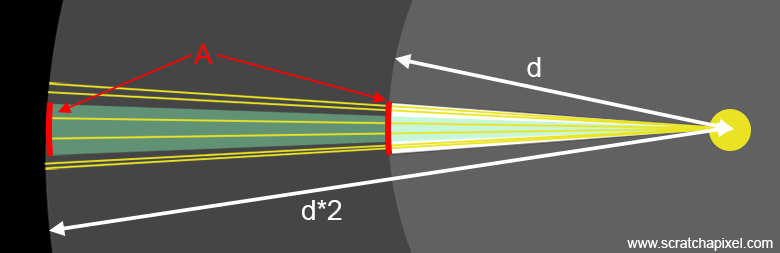

Now let's have a closer look at how irradiance is computed onto a point light source. Radiance is defined as power per unit angle per unit area. Because a point light has no surface area, the standard definition of radiance (power per unit solid angle per unit area) fails. Instead, we define a point light by its Radiant Intensity ($I$), which is the power emitted per unit solid angle ($W/sr$). As this light travels away from the source, the power spreads over the surface of an expanding sphere. To find the Irradiance ($E$)—the power per unit solid angle per unit area arriving at our surface point $x$—we must divide the intensity by the area on the surface of a sphere subtended by one steradian (1 sr) at a distance $r$. Therefore, $L_i \propto \dfrac{I}{r^2}$.
We do this correction for a point light source in `sampleIrradiance` function which takes `fallOffFactor` as input. You need to implement the `fallOffFactor` in `evaluatePointLightContribution`. Upon completion, you'll be able render the scene with point light source kept at the camera position, showing the square fall of of point light's radiance. Notice that the bunny closer to light source is brighter as compared to the dull bunny that's farther away.


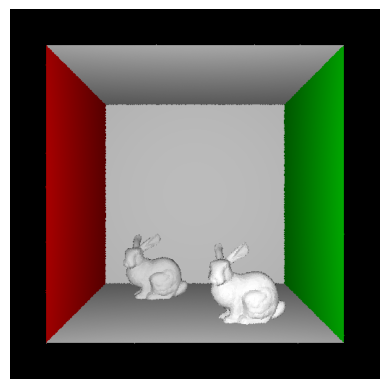


  0%|          | 0/1 [00:00<?, ?it/s]

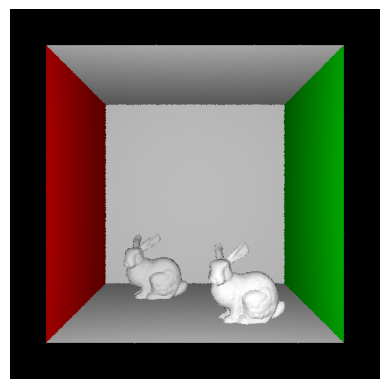

In [9]:
scene = get_cornell_box(mode=CornellBoxMode.SHADOW, light_type=LightType.POINT_LIGHT_AT_CAMERA)
renderer.load_triangles(scene=scene)
renderer.load_lights(scene=scene)
spp = 1
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
    )

plt.imshow(np.flipud(tone_mapping(output_image.to_numpy())))
plt.axis('off')
plt.show()

### Shadows
Now, let's move the Point light to the ceiling. When we render this scene we observe that the bunnies look like they are floating on the floor. This is because of absence of shadows, which makes this scene look unnatural.

In previous cell we mentioned visibility test function $V(x, \omega_i)$. We first shoot a camera ray from camera origin onto the scene. If the BRDF at the ray-mesh hit point allows, it will be reflected onto the light source. This is evaluated by $V(x, \omega_i)$ which is implemented as `isLightOccluded` in the code.

As we have moved the light source away from camera origin to the ceiling, we would want to collect the radiance from there. We shoot a ray from hit point into the light source for this purpose. This ray that's shot from the hit point into the light source is called shadow ray. However, if shadow ray intersects with any geometry in the scene, then it is blocked from reaching the light source and returns a 0 radiance. Because 0 radiance is falling on the hit point, we get a shadow on that point. If the shadow ray hits a light source, it returns a `LightSample`, which describes the light direction, light distance, radiance emitted by the light source, and pdf (used for Monte-Carlo integration, more useful for area lights later in the notebook) falling on the hit point. (Check out `src/cs248a_renderer/slang_shaders/light.slang` for a description of `LightSample`).

Take a look the function `evaluatePointLightContribution` in the file `src/cs248a_renderer/slang_shaders/renderer/mesh_renderer/mesh_illumination.slang`, which makes calls `isLightOccluded` and `getShadowRay` functions. Then complete these functions by following the steps in the code comments. Upon completion you should be able to render a scene as follows:

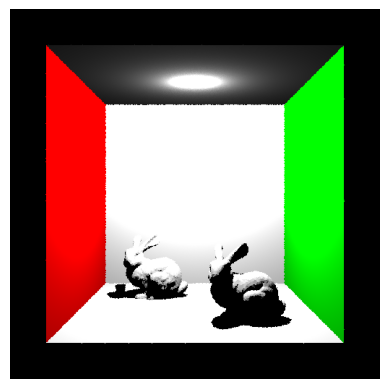

  0%|          | 0/1 [00:00<?, ?it/s]

(np.float64(-0.5), np.float64(511.5), np.float64(511.5), np.float64(-0.5))

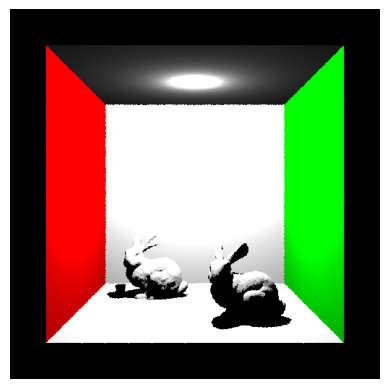

In [10]:
scene = get_cornell_box(mode=CornellBoxMode.SHADOW, light_type=LightType.POINT_LIGHT_ON_THE_CEILING)
renderer.load_triangles(scene=scene)
renderer.load_lights(scene=scene)
spp = 1
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
    )

plt.imshow(np.flipud(tone_mapping(output_image.to_numpy())))
plt.axis('off')

#### Directional Light
Now let's shine a directional light into the scene. A directional light has a direction but no position. For example, sunlight. We can also say that it's a very bright light source that's placed very far. Its intensity does not fall off with distance. Check out the `src/cs248a_renderer/slang_shaders/light/directional_light.slang` for a description of directional light.

Let's look at our scene when we shine a directional light into the scene. What do you observe? Can you reason about the absence of certain objects in the scene?

  0%|          | 0/1 [00:00<?, ?it/s]

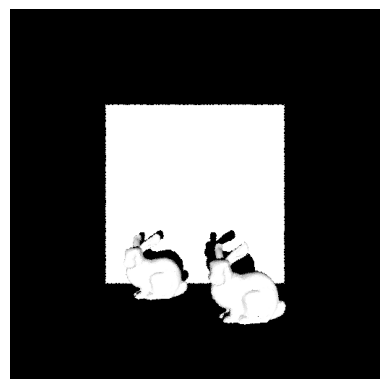

In [11]:
scene = get_cornell_box(mode=CornellBoxMode.SHADOW, light_type=LightType.DIRECTIONAL_LIGHT_INTO_THE_SCENE)
renderer.load_triangles(scene=scene)
renderer.load_lights(scene=scene)
spp = 1
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
    )

plt.imshow(np.flipud(tone_mapping(output_image.to_numpy())))
plt.axis('off')
plt.show()

### Rectangular Lights

A rectangular light (which is an example of area light) is a light source that has a geometry of a rectangle. Unlike the point light and directional light, rectangular light source has an area. When we shine a rectangular light onto the scene, it casts soft shadows, unlike the sharp shadows that we have observed so far with point and direcitonal lights. This happens because it allows surfaces to be partially occluded. In Point and directional light source where the light could fall on the surface hit point only in single direction because both of them do not have any area. On contrary, a rectangular light source has an area and as a result multiple light rays can exit from this light source. These light rays can orient differently to the hit point. Some of them could also get blocked due to scene geometry. This leads to an irregular reduction in irradiance at different hitpoints, which cause a soft shadow.

Monte-Carlo Integration is used to sample from this light source, as covered in class. This means the more you sample on this light source, better will be your estimate of the radiance coming from it onto a hit point. 

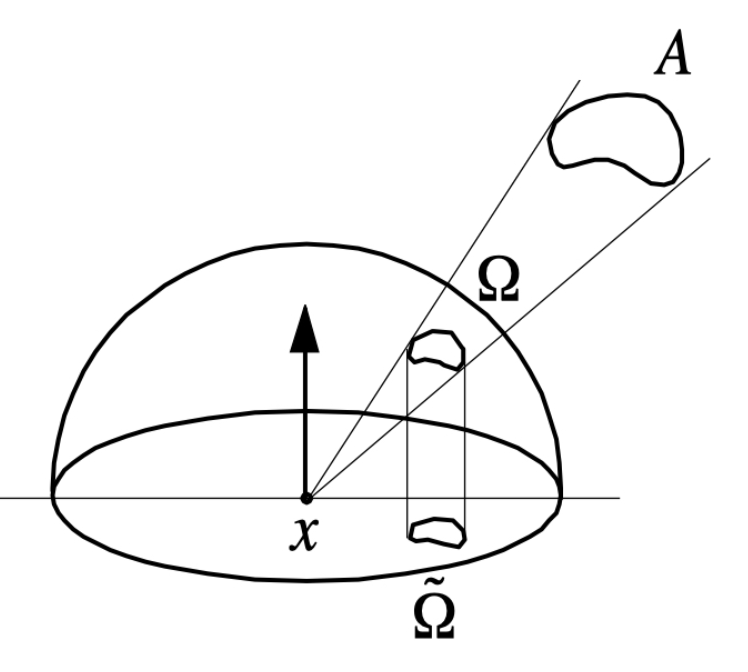

Let's revisit the Monte-Carlo Estimator, which more relevant when dealing with area lights.
$$L_o(x, \omega_o) \approx f_r(x, \omega_o) \underbrace{\left( \frac{1}{N} \sum_{j=1}^{N} V(x, \omega_j)  \frac{L_i(x, \omega_j) \cos\theta_j}{p(\omega_j)} \right)}_{\text{irradiance}}$$
Here, 
1. $N$ is number of samples of light taken on the hemisphere.
2. $\omega_j$ is the sampled direction over unit hemisphere $\Omega$ to check if the light is coming from this direction. This is referred as `lightSample.lightDirection` in our code.
3. $\dfrac{L_i(x, \omega_j) \cos\theta_j}{p(\omega_j)}$ is weighted irradiance from sampled direction $\omega_j$ (ignoring $V(x, \omega_j)$ for ease of reading). It is composed of 2 terms:
   1. $L_i(x, \omega_j) \cos\theta_j$ is referred to as sampled irradiance from a "sampled" direction $\omega_j$; or `sampleIrradiance` in our code.
   2. $p(\omega_j)$ is Probability Density Function (PDF) of choosing direction $\omega_j$. If a point light source exists along $\omega_j$, then this is 1 (this is more nuanced when we get to area lights). This is a correction term in Monte-Carlo integration. Dividing by $p(\omega_j)$ acts as a weight. If a direction $\omega_j$ was very likely to be picked, its contribution is scaled down; if we picked a "rare" direction, its contribution is scaled up. This ensures the final average is correct regardless of how we distributed our rays. This is referred as `lightSample.pdf` in our code.

Unlike 0 area light sources such as Point light, an area light allows can shine light in multiple directions $\omega_j$. Shadow rays can be shot at multiple locations over the geometry of area light to find light, each of these locations would subtend a different angle to the hit point $x$.
Points are sampled on the surface of area light (with an area of $A$ in above figure)  shoot shadow rays into it to get a `LightSample`. Then Monte-Carlo Integration is applied on these irradiance from `LightSample` to estimate total irradiance from the area light source.

If an area light source is very far, then the solid angle $\Omega$ subtended by it would be tiny. This would also mean that we would not need to sample it multiple times to obtain a low-variance (noise-free) estimate of the irradiance, this is because as the light source shrinks toward a single point in the sky, the variance in the integrand $f(x_i)$ decreases, making the light behave more like a point light source where every sample returns nearly identical radiance and geometric information.

If the area light source is oriented perpendicular to its direction from the hit point, then the the solid angle $\Omega$ subtended by it would be 0. This means the light would always shine away from hit point and thus never reaching it.

Let's think about how might we get this pdf.

A point uniformly sampled on the area light source has the pdf of $\dfrac{1}{A}$. If our reflection equation $$L_o(x, \omega_o) = \int_{\Omega} f_r(x, \omega_i, \omega_o) V(x, \omega_i) L_i(x, \omega_i) \cos\theta \, d\omega_i$$
was integrating over the area $A$ then we could have used $\dfrac{1}{A}$ as pdf. But it is integrating over directions (or MC estimating the integral by sampling directions). Can we establish a relationship between $d\omega_i$ and $dA$ for a change of variable to evaluate this integral?

**Change of Variables** 
From Area to Solid Angle: To evaluate the integral over the hemisphere $\Omega$ by sampling points on the rectangular light's surface $A$, we must relate the differential solid angle $d\omega_i$ to the differential area $dA$. Imagine a tiny patch $dA$ on the light source at a distance $r$ from the hit point $x$. The solid angle $d\omega_i$ subtended by that patch is the "projected area" of the patch divided by the distance squared:$$d\omega_i = \frac{dA \cos\theta'}{r^2}$$
Where:  
- $r$: The distance between the hit point $x$ and the sampled point $x'$ on the light (`lightSample.lightDistance`).
- $\cos\theta'$: The cosine of the angle between the light’s surface normal $n'$ and the direction toward the hit point. This accounts for the "tilt" of the light source itself. If the light is tilted away, it appears smaller and subtends a smaller solid angle.

**The Transformed PDF**
When we perform Monte Carlo integration, we must divide the integrand by the PDF of the variable we are actually sampling. We are sampling points uniformly on the area of the rectangle, so our area-based PDF is $p(A) = \frac{1}{\text{Area}}$.However, the rendering equation is defined in terms of solid angle. To use our area samples in a solid-angle integral, we must convert our PDF using the relationship derived above:$$p(\omega) = p(A) \frac{dA}{d\omega_i} = \frac{1}{A} \cdot \frac{r^2}{\cos\theta'}$$

The PDF is no longer a constant; it scales with the distance squared and the orientation of the light.

##### Putting it all together: The Monte-Carlo Estimator
Substituting this $p(\omega)$ back into our Monte Carlo estimator:$$L_o(x, \omega_o) \approx f_r \underbrace{\left( \frac{1}{N} \sum_{j=1}^{N} V \cdot \frac{L_i \cos\theta}{\frac{1}{A} \frac{r^2}{\cos\theta'}} \right)}_{\text{irradiance}} \approx f_r \underbrace{\left( \frac{1}{N} \sum_{j=1}^{N} V \cdot L_i \cdot A \cdot \frac{\cos\theta \cos\theta'}{r^2} \right)}_{\text{irradiance}}$$

Check out the description of `RectangularLight` in `src/cs248a_renderer/slang_shaders/light/rect_light.slang`. Then check out the implementation of Monte-Carlo Integration to get the irradiance from rectangular light sources in `evaluateRectangularLightContribution` in `src/cs248a_renderer/slang_shaders/renderer/mesh_renderer/mesh_illumination.slang`. Now implement `getPdf` for `RectangularLight`.

Upon completion you should see the soft shadows of the bunnies as follows:

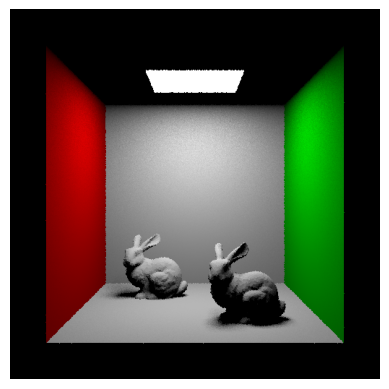

  0%|          | 0/8192 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

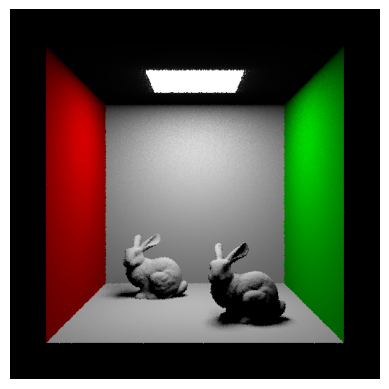

In [12]:
scene = get_cornell_box(mode=CornellBoxMode.SHADOW, light_type=LightType.RECTANGULAR_LIGHT_ON_THE_CEILING)
bvh, triangles, materials = build_bvh(scene)
renderer.load_bvh(triangles=triangles, bvh=bvh)
renderer.load_materials(materials=materials)
renderer.load_lights(scene=scene)
spp = 1
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        num_rectangular_light_samples=64
    )

plt.imshow(np.flipud(tone_mapping(output_image.to_numpy())))
plt.axis('off')
plt.show()

Now let's examine how Monte-Carlo estimates affect the of the radiance from the rectangular light source. in our renderer Monte-Carlo Estimator is used at two places:

1. When we shoot multiple ray within a pixel and then estimate the radiance falling into it. You did this as part of supersampling in assignment 1. More rays shot per pixel means we are grabbing the samples from the light source more number of times, thus decreasing variance of the MC Estimate of radiance falling on the pixel. As you see below, this is seen as grainy images being rendered at lower (ray) samples per pixel or spp.

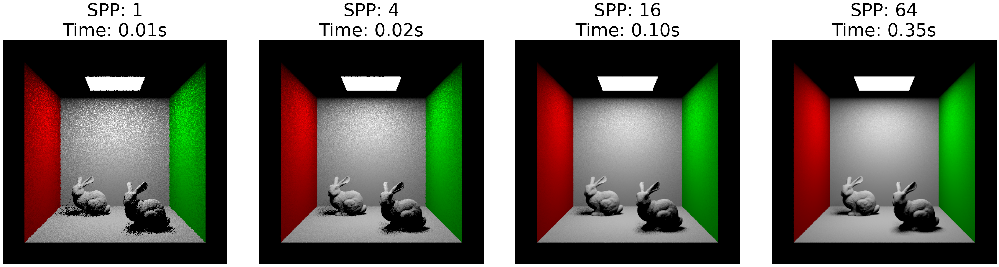

In [13]:
class SampleMode(Enum):
    PER_PIXEL = "per_pixel"
    ON_LIGHT = "on_light"

def render_with_more_samples(renderer, bvh, triangles, materials, mode: SampleMode):
    output_images = {}
    NUM_STEPS = 4
    for i in range(NUM_STEPS):
        if mode == SampleMode.PER_PIXEL:
            spp = 4**i
            num_rect_light_samples = 1
        elif mode == SampleMode.ON_LIGHT:
            spp = 1
            num_rect_light_samples = 4**i
        # time the render
        renderer.load_bvh(triangles=triangles, bvh=bvh)
        renderer.load_materials(materials=materials)
        renderer.load_lights(scene=scene)
        renderer.clear_render_target()
        start_time = time()
        for _ in range(spp):
            renderer.render_step(
                scene.camera.view_matrix(),
                scene.camera.fov,
                num_rectangular_light_samples=num_rect_light_samples,
            )
        end_time = time()
        time_taken = end_time - start_time
        output_image_np = np.flipud(tone_mapping(output_image.to_numpy())).clip(0, 1)
        output_images[i] = {
            'rendering': output_image_np,
            'time_taken': time_taken
        }
    
    return output_images

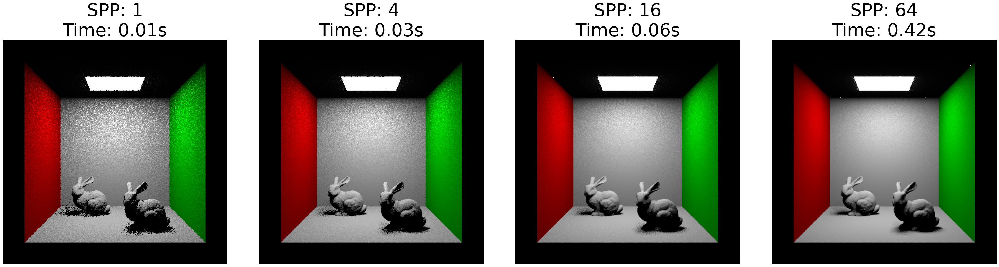

In [14]:
NUM_STEPS = 4
output_images = render_with_more_samples(renderer, bvh, triangles,materials, SampleMode.PER_PIXEL)
fig = plt.figure(figsize=(10 * NUM_STEPS, 10))
for i in range(NUM_STEPS):
    ax = fig.add_subplot(1, NUM_STEPS, i + 1)
    ax.imshow(output_images[i]['rendering'])
    ax.set_title(f'SPP: {4**i}\nTime: {output_images[i]['time_taken']:.2f}s', fontsize=50)
    ax.axis('off')
plt.tight_layout()
plt.show()

2. If we increase the number of area light samples (shot from hit point into the area light source) and fix the spp=1 (effective disabling the previous MC estimator by shooting only one ray per pixel), then also we see the same effect of higher variance estimate at lower area light samples. Do you also notice that at higher samples this estimator is faster to produce a smoother image than the previous one? If your answer is yes, can you reason about it? If your answer is no, then can you think of a way to it faster? (HINT: Look at `isLightOccluded` function)
   
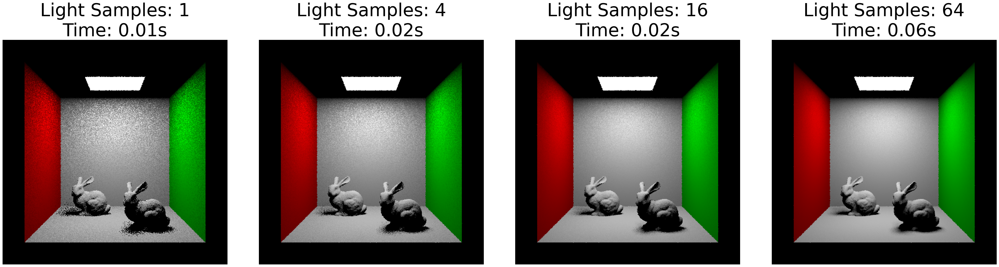

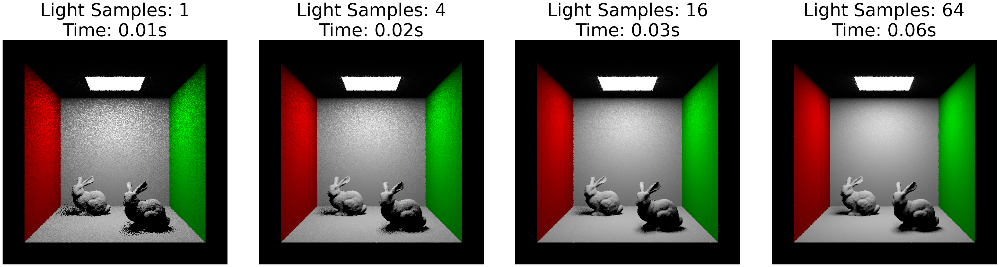

In [15]:
# Increase the number of samples on the light source.
NUM_STEPS = 4
output_images = render_with_more_samples(renderer, bvh, triangles, materials, SampleMode.ON_LIGHT)
fig = plt.figure(figsize=(10 * NUM_STEPS, 10))
for i in range(NUM_STEPS):
    ax = fig.add_subplot(1, NUM_STEPS, i + 1)
    ax.imshow(output_images[i]['rendering'])
    ax.set_title(f'Light Samples: {4**i}\nTime: {output_images[i]['time_taken']:.2f}s', fontsize=50)
    ax.axis('off')
plt.tight_layout()
plt.show()

## Part 2: Indirect Illumination

We just successfully implemeted the direct illumination, where a ray from light source bounced off the surface and directly entered the camera. But in reality, a light ray keeps bouncing from surfaces in the scene multiple times. At each bounce, it's radiance would be affected according to the BRDF at the surface hit point. Thus, every point on the surface acts as a light source once a light ray bounces off it. This is called indirect illumination. Our renderer can support multiple bounces of light by setting `path_trace_depth` variable, which is 1 by default (simulates just 1 bounce of light ray).

How a light ray could be bouncing off a surface is property of its BRDF. We have been using a Lambertian BRDF so far, which can reflect a incoming light ray into all the directions (on the upper hemisphere around the surface normal at its hit point).

In a path tracer, we start from the ray entering to into the camera and trace its way back to the light source. This is what you also did with the shadow ray implementation for direct illumination. Whereas reality a light ray is first incident onto the surface from light source and then is reflected by the BRDF into the camera. We do not simulate the real nature light ray simulation (called light transport simulation) because it is computationally inefficient, as compared to path tracing which could be easily broken down into direct and indirect illumination and quickly converge to a well illuminated image.

To implement indirect illumination, we are going to do something that we did with shadow ray again. We'll shoot a ray into the scene, but this time the ray's direction will be sampled from BRDF function at the surface hit point.

1. Implement the functions `sample` and `pdf` for `LambertianBRDF` in `src/cs248a_renderer/slang_shaders/brdf/lambertian.slang`. We are going to implement a Uniform sampling scheme around the upper hemisphere as covered in the class.
2. Check out `sampleBRDF` in `src/cs248a_renderer/slang_shaders/renderer/mesh_renderer/mesh_illumination.slang` and use it in Step 4a of `meshSample` function in `src/cs248a_renderer/slang_shaders/renderer/mesh_renderer.slang`.
3. Update the `thoughtput` variable in `meshSample` function. Initially we assume 100% the light can pass into the camera. But as the light bounces, some of it is absorbed by the material as defined by it's BRDF and fraction of it is reflected. This decreases the throughput.
4. Update the ray to be shot into the scene after the current bounce (or for the next iteration of the depth of the path tracer loop) in `meshSample` function.

Upon a successful implementation of all these components, you should be able render an image as follows. Note the well lit ceiling which was absent when using direct illumination.

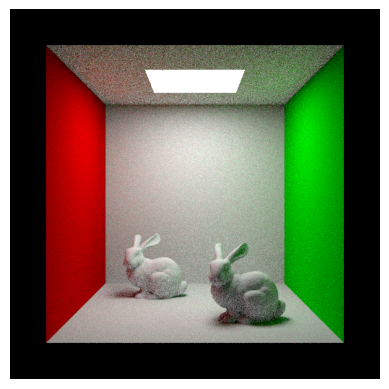


  0%|          | 0/16 [00:00<?, ?it/s]

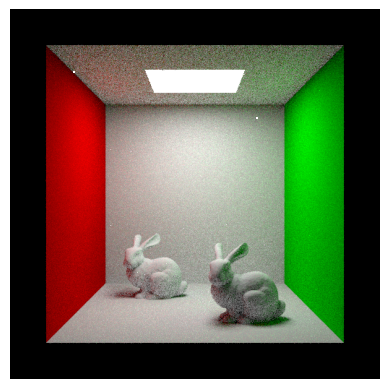

In [16]:
renderer.load_bvh(triangles=triangles, bvh=bvh)
renderer.load_materials(materials=materials)
renderer.load_lights(scene=scene)
renderer.clear_render_target()
spp = 16
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        num_rectangular_light_samples=4,
        path_trace_depth=2
    )

plt.imshow(np.flipud(tone_mapping(output_image.to_numpy())))
plt.axis('off')
plt.show()

As we increase the bounces of the light, we see an image an image that more lit. We also notice that the change in illumination in the image over previous bounce diminishes at higher bounces.

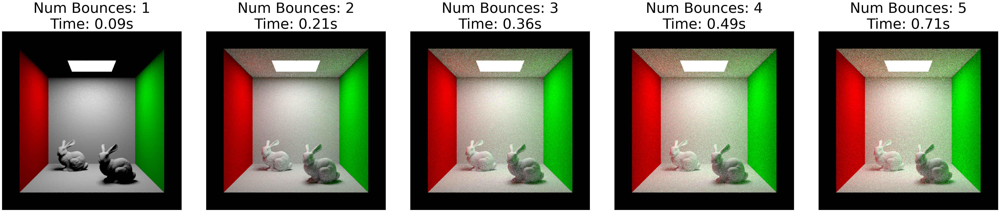

In [17]:
def render_with_more_bounces(renderer, bvh, triangles, materials, num_bounces: int):
    output_images = {}
    for i in range(1, num_bounces + 1):
        # time the render
        start_time = time()
        renderer.load_bvh(triangles=triangles, bvh=bvh)
        renderer.load_materials(materials=materials)
        renderer.load_lights(scene=scene)
        renderer.clear_render_target()
        spp = 16
        start_time = time()
        for _ in range(spp):
            renderer.render_step(
                scene.camera.view_matrix(),
                scene.camera.fov,
                num_rectangular_light_samples=4,
                path_trace_depth=i
            )
        end_time = time()
        time_taken = end_time - start_time
        output_image_np = np.flipud(tone_mapping(output_image.to_numpy()).clip(0, 1))
        output_images[i] = {
            'rendering': output_image_np,
            'time_taken': time_taken
        }
    
    return output_images

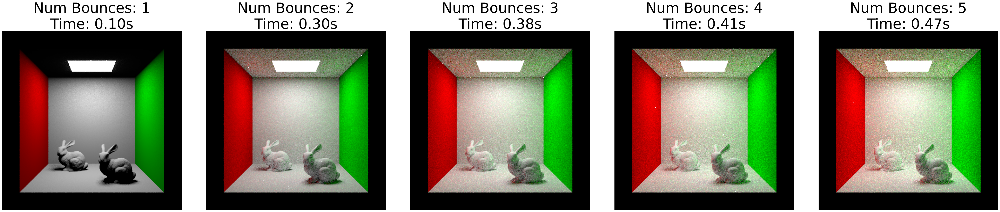

In [18]:
NUM_BOUNCES = 5
output_images = render_with_more_bounces(renderer, bvh, triangles, materials, NUM_BOUNCES)
fig = plt.figure(figsize=(10 * NUM_BOUNCES, 10))
for i in range(1, NUM_BOUNCES + 1):
    ax = fig.add_subplot(1, NUM_BOUNCES, i)
    ax.imshow(output_images[i]['rendering'])
    ax.set_title(f'Num Bounces: {i}\nTime: {output_images[i]['time_taken']:.2f}s', fontsize=50)
    ax.axis('off')
plt.tight_layout()
plt.show()

#### Extra Credit: Implement Cosine Weighted Sampling for Lambertian Surfaces

Cosine-weighted sampling converges faster than uniform sampling because it prioritizes directions that have the highest potential to influence the final pixel color. According to Lambert’s Cosine Law, the irradiance received by a surface is proportional to the cosine of the angle between the incident light and the surface normal ($\cos \theta$) (recall Lambert's Cosine Law which is obseved by Lambertian surfaces). While we cannot predict where the most radiance ($L$) is coming from in a complex scene, we know for certain that the surface is most "sensitive" to light arriving from directions near the normal. Uniform sampling wastes computational effort by shooting rays at grazing angles where the $\cos \theta$ term is near zero, meaning those rays contribute almost nothing to the final integral. By using Importance Sampling, we align our sample distribution $P(x)$ with the known shape of the integrand (the $\cos \theta$ term). 

At low path depths or low samples-per-pixel (SPP), cosine-weighted sampling produces a noticeably smoother image. While uniform sampling creates "grainy" noise—caused by the high-weight samples at grazing angles—cosine-weighted sampling ensures that every ray traced is likely to carry a meaningful amount of energy back to the camera.

Implement the code in the `useCosineWeightedSampling` condition in `sample` and `pdf` functions of `LambertianBRDF` in `src/cs248a_renderer/slang_shaders/brdf/lambertian.slang`. Upon a successful implementation, you should be able get following comparison of Uniform and Cosine Weighted sampling from the following cell. Notice the grainy effect on the ceiling when using Uniform sampling that's smoothened after switching to Cosine Weighted Sampling.

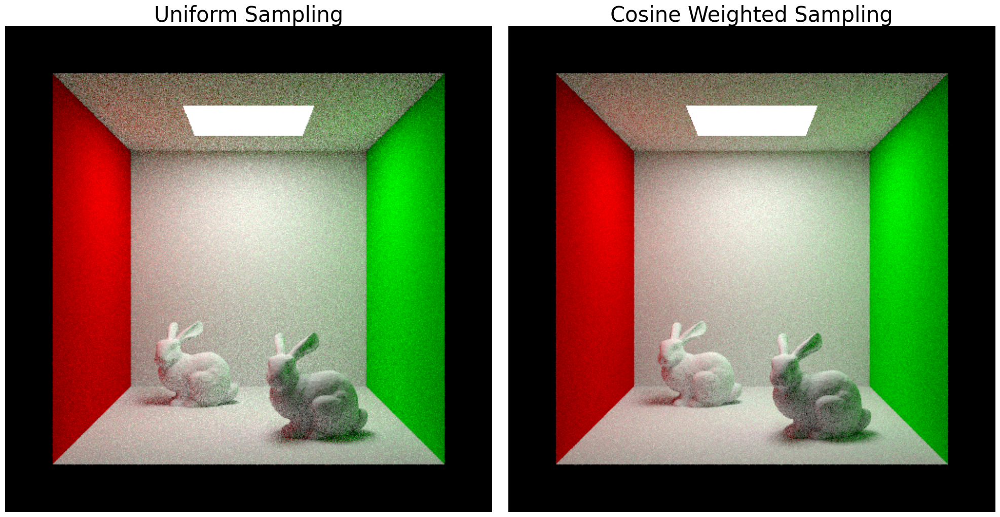

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

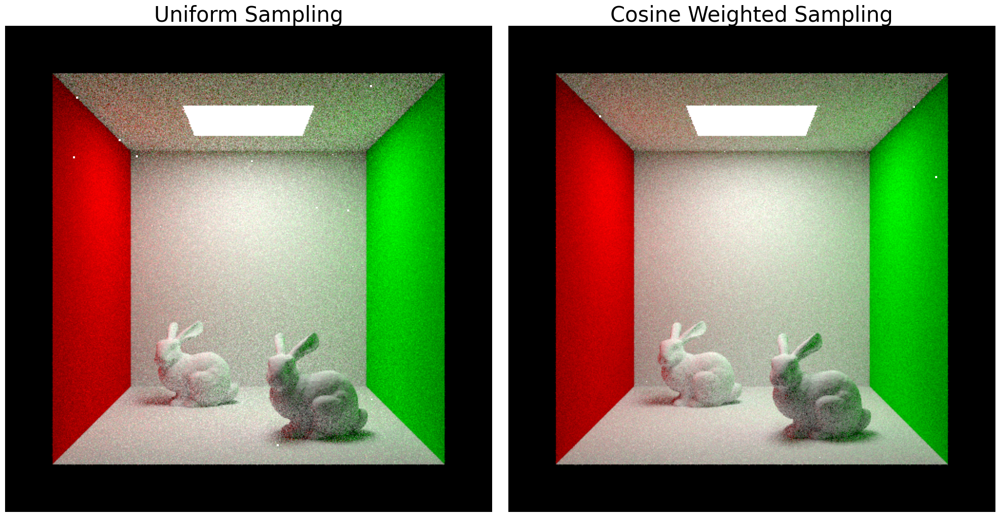

In [19]:
renderer.load_bvh(triangles=triangles, bvh=bvh)
renderer.load_materials(materials=materials)
renderer.load_lights(scene=scene)

spp = 16
# Render with Uniform Sampling
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        num_rectangular_light_samples=4,
        path_trace_depth=3
    )
uniform_image_np = np.flipud(tone_mapping(output_image.to_numpy()).clip(0, 1))

# Render with Cosine Weighted Sampling
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        num_rectangular_light_samples=4,
        path_trace_depth=3,
        use_cosine_weighted_sampling=True
    )
cosine_image_np = np.flipud(tone_mapping(output_image.to_numpy()).clip(0, 1))

# Display the images side by side with labels
fig, axes = plt.subplots(1, 2, figsize=(20, 10))
for ax, label, image in zip(axes, ['Uniform Sampling', 'Cosine Weighted Sampling'], [uniform_image_np, cosine_image_np]):
    ax.imshow(image)
    ax.set_title(label, fontsize=30)
    ax.axis('off')
plt.tight_layout()
plt.show()



## Part 3: More BRDFs; More Effects
We have successfully implemented the core funcitonality of a path tracer to demonstrate global illumination. Now let's extend it to support materials with different kinds of BRDFs. We'll implement mirror and glass BRDF which exhibit visual effects of reflection and caustics.

### Mirror BRDF: Reflection

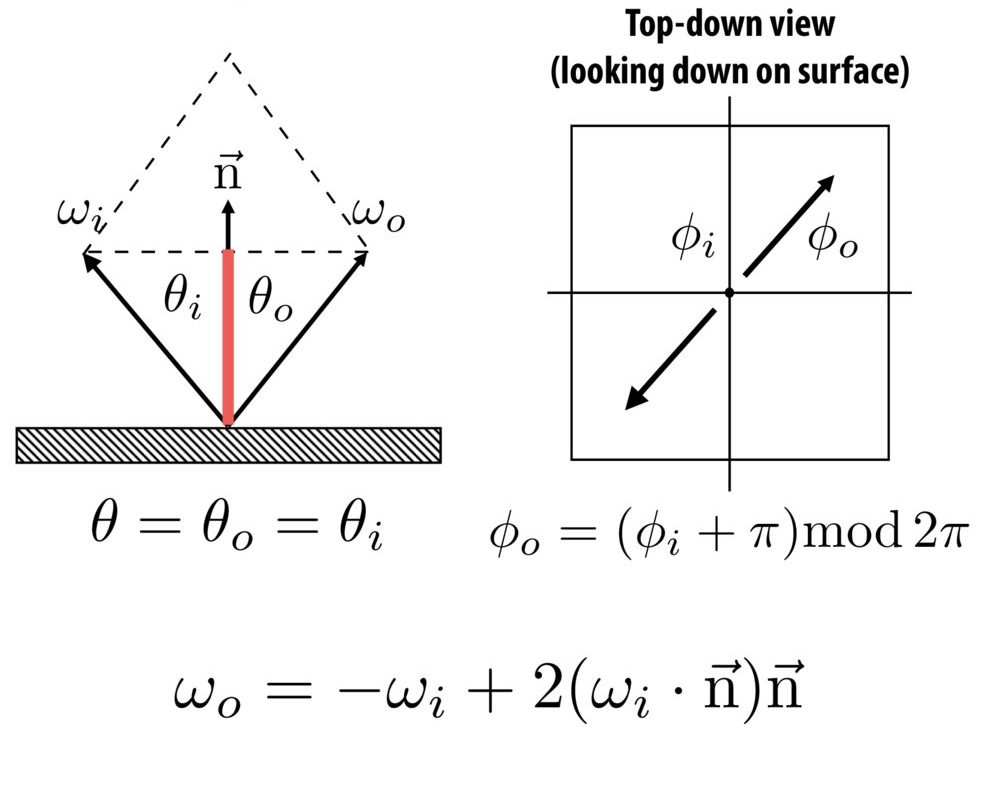

A perfect mirror reflects the light ray that's incident on it in the direction determined by the law of reflection, where the angle of incidence is equal to the angle of reflection. $$\omega_o = - \omega_i + 2(\omega_i \cdot \mathbf{n})\mathbf{n} $$

where, $\omega_o$ is the reflected ray, $\omega_i$ is the incident ray, and $n$ being surface normal at the hit point.

In a path tracer, this is treated as a singular (delta) distribution. Unlike a Lambertian surface that reflects light in all directions, a mirror has a probability of zero for reflection in any direction except for the one exact "perfect" reflection direction.

Implement the `sample` and `pdf` functions in the `MirrorBRDF` in `src/cs248a_renderer/slang_shaders/brdf/mirror.slang`. Upon a successful implementation, you should be able to render an image like follows. Notice the reflections on the mirror.

![mirror](../../assets/mirror_d2.png)

  0%|          | 0/8192 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

(np.float64(-0.5), np.float64(511.5), np.float64(511.5), np.float64(-0.5))

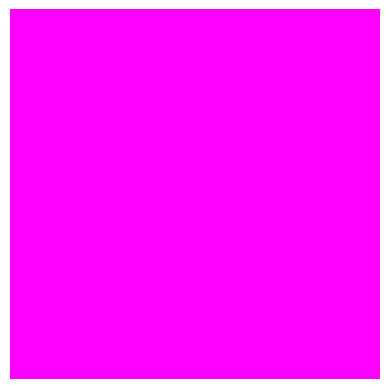

: 

: 

: 

In [ ]:
scene = get_cornell_box(mode=CornellBoxMode.MIRROR_OBJECTS, light_type=LightType.RECTANGULAR_LIGHT_ON_THE_CEILING)
bvh, triangles, materials = build_bvh(scene)
renderer.load_bvh(triangles=triangles, bvh=bvh)
renderer.load_materials(materials=materials)
renderer.load_lights(scene=scene)
renderer.clear_render_target()
spp = 16
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        num_rectangular_light_samples=4,
        path_trace_depth=2,
    )
plt.imshow(np.flipud(tone_mapping(output_image.to_numpy()).clip(0, 1)))
plt.axis('off')

Let's compare this scene with a mirror BRDF under only direct illumination against using indirect illumination. Why do you observe a black bunny under direct illumination? What changed in the indirect illumination?

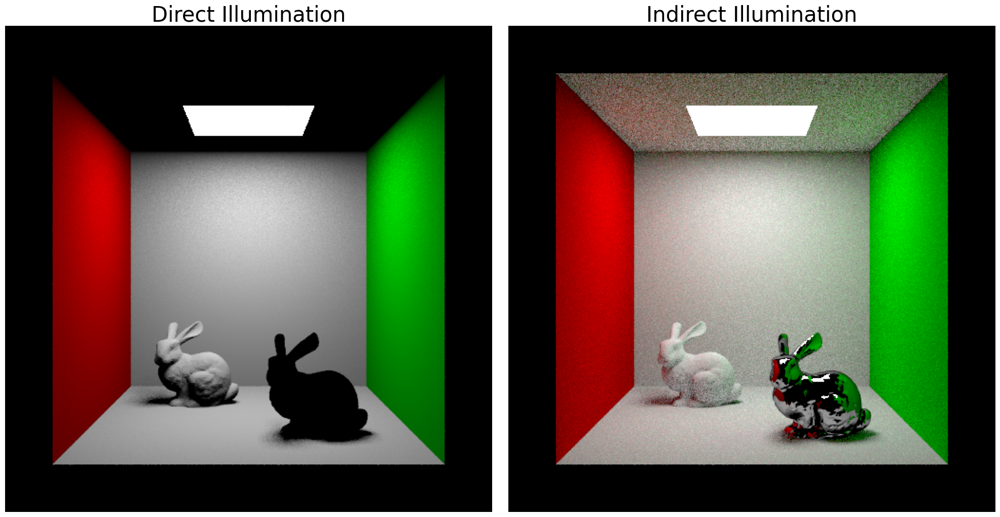

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

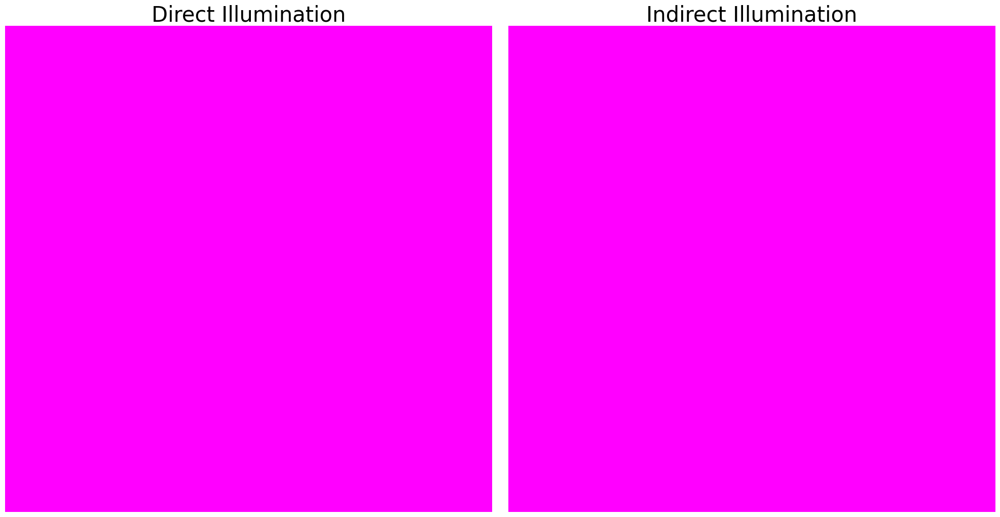

: 

: 

: 

In [ ]:
renderer.load_bvh(triangles=triangles, bvh=bvh)
renderer.load_materials(materials=materials)
renderer.load_lights(scene=scene)

spp = 16
# Render Mirror with Direct Illumination
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        num_rectangular_light_samples=4,
        path_trace_depth=1
    )
mirror_direct_image_np = np.flipud(tone_mapping(output_image.to_numpy()).clip(0, 1))

# Render Mirror with Indirect Illumination
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        num_rectangular_light_samples=4,
        path_trace_depth=2,
    )
mirror_indirect_image_np = np.flipud(tone_mapping(output_image.to_numpy()).clip(0, 1))

# Display the images side by side with labels
fig, axes = plt.subplots(1, 2, figsize=(20, 10))
for ax, label, image in zip(axes, ['Direct Illumination', 'Indirect Illumination'], [mirror_direct_image_np, mirror_indirect_image_np]):
    ax.imshow(image)
    ax.set_title(label, fontsize=30)
    ax.axis('off')
plt.tight_layout()
plt.show()

### Glass BRDF: Refraction and Caustics

In `src/cs248a_renderer/slang_shaders/brdf/glass.slang`, implement the `sample` function for `GlassBRDF`. Similar to the `MirrorBRDF`, the sample function takes the outgoing direction `wo` and the surface normal `n`, and it should return the incoming direction `wi`.

The refracted ray follows Snell's law, which states that:

$$n_1 \sin \theta_1 = n_2 \sin \theta_2$$

where $n_1$ and $n_2$ are the indices of refraction for the two media, $\theta_1$ is the angle between the incident ray and the normal, and $\theta_2$ is the angle between the refracted ray and the normal. You can calculate the refracted ray direction using the following formula:
$$w_i = -\eta w_o + \left( \eta \cos \theta_1 - \sqrt{1 - \eta^2 (1 - \cos^2 \theta_1)} \right) n$$
Where:  
- $\eta = \frac{n_1}{n_2}$ (the ratio of the refractive indices).
- $\cos \theta_1 = w_o \cdot n$.

### Total Internal Reflection

When light travels from a medium with a higher index of refraction to a medium with a lower index of refraction, there is a possibility of total internal reflection. This occurs when the angle of incidence exceeds the critical angle, which can be calculated as:

$$\theta_c = \arcsin\left(\frac{n_2}{n_1}\right)$$

If the angle of incidence exceeds the critical angle, total internal reflection occurs, and the ray is completely reflected.

In this case, you should return the reflected ray direction the same way as in the `MirrorBRDF`.

If you implement the refraction correctly, you should see the following result when rendering the Cornell box with glass materials:

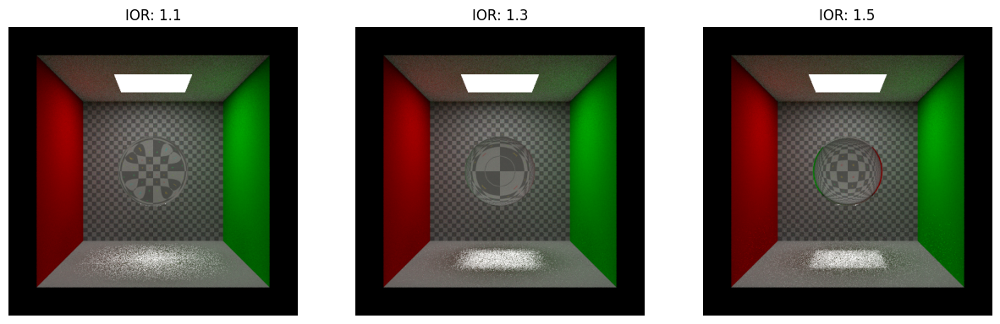

Notice as the IOR of the glass increases, the refracted light on the floor becomes more concentrated. This is called the caustics effect and the glass ball is essentially acting as a lens that focuses the light.

> Think: what should the image look like if the IOR is 1.0? What about if the IOR is less than 1.0?

In [ ]:
spp = 64
iors = [1.1, 1.3, 1.5]
output_images = []

for ior in iors:
    scene = get_cornell_box(mode=CornellBoxMode.GLASS_BALL, light_type=LightType.RECTANGULAR_LIGHT_ON_THE_CEILING_DIMMER, ior=ior)
    # Build BVH for the scene
    bvh, triangles, mateirals = build_bvh(scene)
    renderer.load_bvh(triangles, bvh)
    renderer.load_materials(mateirals)
    renderer.load_lights(scene=scene)
    renderer.clear_render_target()
    for i in tqdm(range(spp)):
        renderer.render_step(
            scene.camera.view_matrix(),
            scene.camera.fov,
            smooth_shading=True,
            path_trace_depth=2,
            fresnel_effect=False
        )
    output_images.append(output_image.to_numpy())

  0%|          | 0/8192 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/8192 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/8192 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

: 

: 

: 

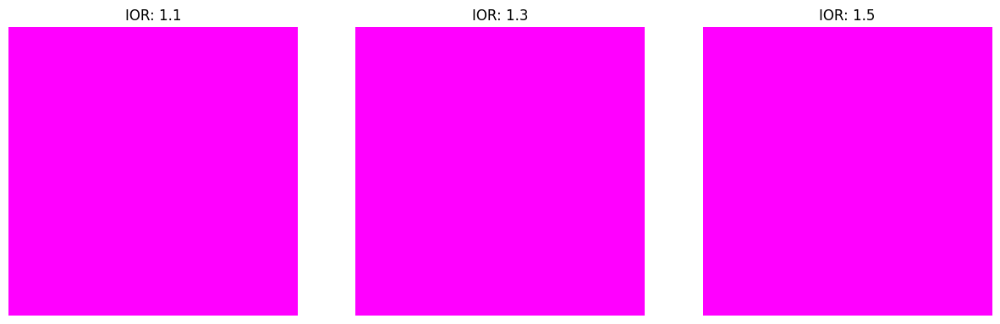

: 

: 

: 

In [ ]:
fig, axes = plt.subplots(1, len(iors), figsize=(15, 5))
for ax, img, ior in zip(axes, output_images, iors):
    ax.imshow(np.flipud(tone_mapping(img)))
    ax.set_title(f"IOR: {ior}")
    ax.axis('off')
plt.show()

### Extra Credit: Fresnel Effect with Russian Roulette

Now, the glass material can refract the light correctly, but it still looks like something is missing. In reality, the glass surface should reflect some portion of the light, and the amount of reflected light should depend on the angle of incidence. This phenomenon is called the Fresnel effect.

The Fresnel effect can be approximated using the following formula:

$$R(\theta) = R_0 + (1 - R_0) \cdot (1 - \cos \theta)^5$$

where $R_0$ is the reflectance at normal incidence, which can be calculated as:

$$R_0 = \left(\frac{n_1 - n_2}{n_1 + n_2}\right)^2$$

where $n_1$ and $n_2$ are the indices of refraction for the two media.

Please read https://en.wikipedia.org/wiki/Schlick%27s_approximation for more details.

## How do We Blend Reflection and Refraction?

To blend reflection and refraction, we can apply the Russian roulette technique we covered in the lecture. When a ray hits the glass surface, we can calculate the Fresnel reflectance $R(\theta)$ and use it as the probability to decide whether to reflect or refract the ray.

For example, if $R(\theta) = 0.3$, we can generate a random number between 0 and 1. If the random number is less than 0.3, we reflect the ray; otherwise, we refract the ray.

Implement Fresnel effect with Russian roulette in `src/cs248a_renderer/slang_shaders/renderer/mesh_renderer/mesh_illumination.slang`. If you implement it correctly, you should see the following result when rendering the Cornell box with glass materials:

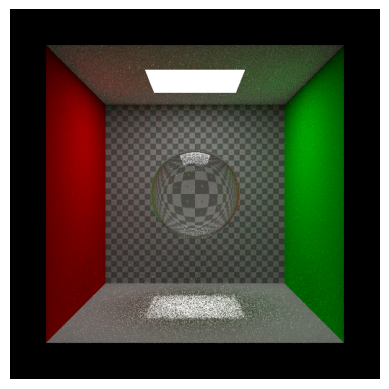

In [19]:
scene = get_cornell_box(mode=CornellBoxMode.GLASS_BALL, light_type=LightType.RECTANGULAR_LIGHT_ON_THE_CEILING_DIMMER, ior=1.5)
# Build BVH for the scene
bvh, triangles, mateirals = build_bvh(scene)
renderer.load_bvh(triangles, bvh)
renderer.load_materials(mateirals)
renderer.load_lights(scene=scene)

  0%|          | 0/8192 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

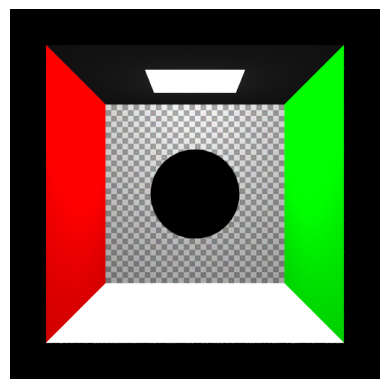

In [21]:
spp = 64
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        smooth_shading=True,
        path_trace_depth=2,
        fresnel_effect=True,
    )

plt.imshow(np.flipud(tone_mapping(output_image.to_numpy())))
plt.axis('off')
plt.show()

## Putting it All Together

Finally, let's renderer some nice images with different mateirals in the same scene. We've prepared a Cornell box scene for you in the assignment 3 google drive: https://drive.google.com/drive/folders/1kT2JPlwDfBr8oHNwdRPJnOsRY1iFvcUD?usp=sharing

Please download the `cbox.zip` file and put it in the `resources` folder (DO NOT unzip it).

If all your path tracer code is correct, you should be able to render the following image with the Cornell box scene:

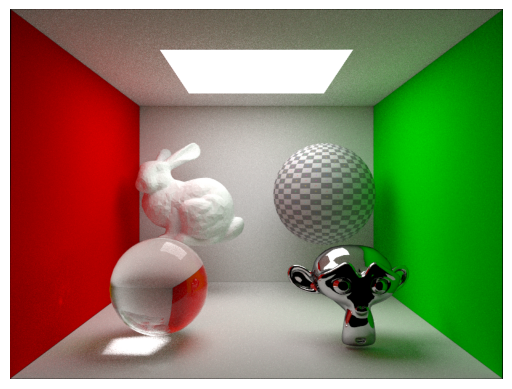

In [22]:
# Load the cornell box scene.
scene_manager = SceneManager()
scene_manager.deserialize_scene("../../resources/cbox.zip")
scene = scene_manager.scene

In [23]:
OUTPUT_IMG_SIZE = (800, 600)
output_image = device.create_texture(
    type=spy.TextureType.texture_2d,
    format=spy.Format.rgba32_float,
    usage=spy.TextureUsage.unordered_access,
    width=OUTPUT_IMG_SIZE[0],
    height=OUTPUT_IMG_SIZE[1],
)
renderer = Renderer(
    device=device,
    render_texture=output_image,
    render_modules=renderer_modules
)

In [24]:
# Build BVH for the scene
bvh, triangles, materials = build_bvh(scene)
renderer.load_bvh(triangles, bvh)
renderer.load_materials(materials)
renderer.load_lights(scene=scene)

  0%|          | 0/8192 [00:00<?, ?it/s]

In [25]:
spp = 256
renderer.clear_render_target()
for i in tqdm(range(spp)):
    renderer.render_step(
        scene.camera.view_matrix(),
        scene.camera.fov,
        smooth_shading=True,
        path_trace_depth=4,
    )

  0%|          | 0/256 [00:00<?, ?it/s]

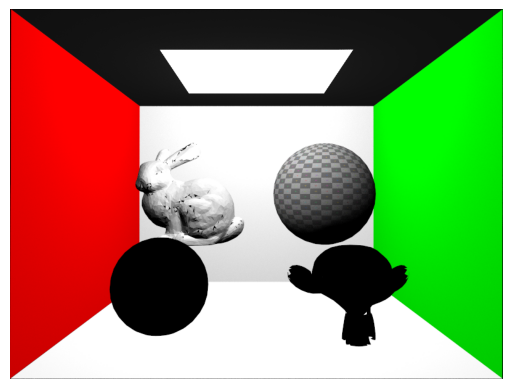

In [26]:
plt.imshow(np.clip(np.flipud(tone_mapping(output_image.to_numpy(), exposure_time=1.0)), 0, 1))
plt.axis('off')
plt.show()

# Save the rendered image
image = Image.fromarray((np.clip(np.flipud(tone_mapping(output_image.to_numpy(), exposure_time=1.0)), 0, 1) * 255).astype(np.uint8))
image.save("cornell_box_render.png")

### Extra Credit: Build Your Own Scene

Try to build your own models with your favorite 3D modeling software (e.g., Blender), download online (e.g., from https://sketchfab.com/), or using the latest generative AI tools. Import them into the interactive renderer and render them with the path tracer you implemented.

Submit a rendered image of your scene.

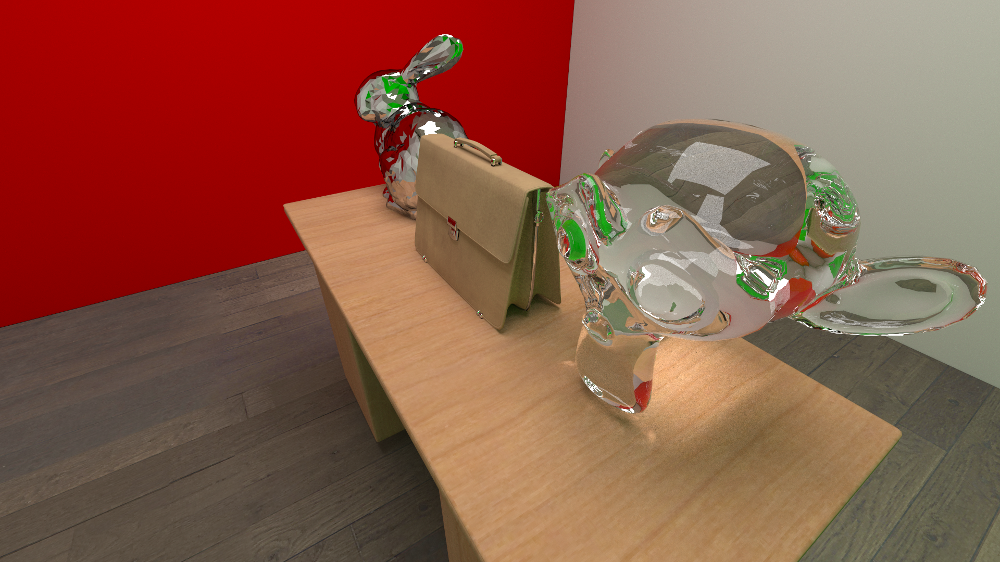